## Reducing embedding size with PCA and quantization

In [ ]:
%pip install -q open_clip_torch

In [ ]:
%%capture
%env AWS_REQUEST_PAYER=requester
%env AWS_ACCESS_KEY_ID=
%env AWS_SECRET_ACCESS_KEY=
%env AWS_SESSION_TOKEN=

---

In [ ]:
from rastervision.core.box import Box
from rastervision.core.data import RasterioSource

from tqdm.auto import tqdm
import numpy as np
import torch
import geopandas as gpd
from matplotlib import pyplot as plt
import seaborn as sns
sns.reset_defaults()

---

## Load embeddings

In [ ]:
# !aws s3 cp s3://raster-vision-ahassan/naip/skyscript_naip_MA_400_400.pt .
# !aws s3 cp s3://raster-vision-ahassan/naip/skyscript_naip_MA_800_800.pt .
# !aws s3 cp s3://raster-vision-ahassan/naip/skyscript_naip_MA_1600_1600.pt .

In [47]:
embs_400 = torch.load('data/skyscript_naip_MA_400_400.pt')
# embs_800 = torch.load('skyscript_naip_MA_800_800.pt')
# embs_1600 = torch.load('skyscript_naip_MA_1600_1600.pt')
embs_400.shape, #embs_800.shape, #embs_1600.shape

(torch.Size([563379, 768]),)

---

## Load chip windows

In [ ]:
# !aws s3 cp s3://raster-vision-ahassan/naip/naip_MA_400_400_w_uris.json .
# !aws s3 cp s3://raster-vision-ahassan/naip/naip_MA_800_800_w_uris.json .
# !aws s3 cp s3://raster-vision-ahassan/naip/naip_MA_1600_1600_w_uris.json .

In [ ]:
windows_df_400 = gpd.read_file('data/naip_MA_400_400_w_uris.json')
# windows_df_800 = gpd.read_file('naip_MA_800_800_w_uris.json')
# windows_df_1600 = gpd.read_file('naip_MA_1600_1600_w_uris.json')

---

## Init `RasterSource`s

In [ ]:
uris = set(windows_df_400.uri)
_uri_to_rs = {}

---

## Load model

In [ ]:
import open_clip

model_name = 'ViT-L-14'
model, _, preprocess = open_clip.create_model_and_transforms(model_name)
tokenizer = open_clip.get_tokenizer(model_name)

In [ ]:
ckpt_path = 'data/SkyCLIP_ViT_L14_top50pct/epoch_20.pt'
ckpt = torch.load(ckpt_path, map_location='cpu')['state_dict']
ckpt = {k[len('module.'):]:v for k, v in ckpt.items()}
model.load_state_dict(ckpt)
model = model.eval()

## Search

In [ ]:
def uri_to_rs(uri: str):
    if uri not in _uri_to_rs:
        _uri_to_rs[uri] = RasterioSource(uri, channel_order=[0, 1, 2], allow_streaming=True)
    return _uri_to_rs[uri]

In [ ]:
def emb_idx_to_chip(i, windows_df, out_shape=(400, 400)):
    i = int(i)
    uri = windows_df.uri.iloc[i]
    window_geom = windows_df.geometry.iloc[i]
    window = Box.from_shapely(window_geom)
    rs = uri_to_rs(uri)
    chip = rs.get_chip_by_map_window(window, out_shape=out_shape)
    return chip

In [ ]:
def show_top_chips(chip_scores, windows_df, top_inds=None, nrows=5, ncols=5, figsize=(12, 12), w_pad=-2.5, h_pad=-2.5, title=None):
    plt.close('all')
    fig, axs = plt.subplots(nrows, ncols, figsize=figsize)
    fig.tight_layout(w_pad=w_pad, h_pad=h_pad)
    if top_inds is None:
        top_inds = torch.topk(chip_scores, axs.size).indices
    for ax, i in zip(tqdm(axs.flat), top_inds):
        chip = emb_idx_to_chip(i, windows_df)
        ax.imshow(chip)
    for ax in axs.flat:
        ax.axis('off')
    if title is not None:
        fig.suptitle(title, y=1.)
    plt.show()
    return fig

In [ ]:
def get_chip_scores(text_queries, embs):
    assert len(text_queries) == 1
    text_emb = get_text_emb(text_queries)
    chip_scores = _get_chip_scores(text_emb, embs)
    return chip_scores

def get_chip_scores_pca(text_queries, embs, pca, num_pcs):
    assert len(text_queries) == 1
    text_emb = get_text_emb(text_queries)
    text_emb_pca = pca.transform(text_emb)[:, num_pcs]
    chip_scores = _get_chip_scores(text_emb, embs)
    return chip_scores

def get_text_emb(text_queries):
    with torch.inference_mode():
        text = tokenizer(text_queries)
        text_emb = model.encode_text(text)
        text_emb /= text_emb.norm(dim=-1, keepdim=True)
        text_emb = text_emb.cpu()
    return text_emb

def _get_chip_scores(text_emb, image_embs):
    with torch.inference_mode():
        chip_scores = torch.cosine_similarity(text_emb, image_embs)
    return chip_scores

  0%|          | 0/8 [00:00<?, ?it/s]

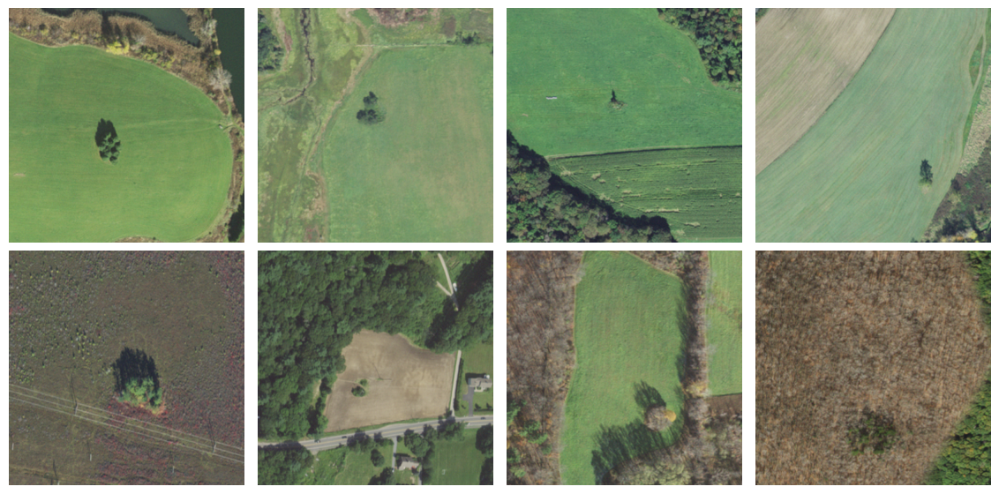

In [61]:
text_queries = [
    # 'house with swimming pool',
    'a single tree in an empty field',
    # 'a large solar farm',
    # 'a long bridge over a large body of water',
    # 'shipping facility',
    # 'warehouse',
    # 'cargo terminal',
    # 'logistics center',
    # 'shipping containers',
    # 'bridges',
]
chip_scores_400 = get_chip_scores(text_queries, embs_400)
_ = show_top_chips(chip_scores_400, windows_df_400, nrows=2, ncols=4, figsize=(12, 6), w_pad=-(12/4), h_pad=-(6/4))
# chip_scores_800 = get_chip_scores(text_queries, embs_800)
# _ = show_top_chips(chip_scores_800, windows_df_800, nrows=2, ncols=4, figsize=(12, 6), w_pad=-(12/4), h_pad=-(6/4))
# chip_scores_1600 = get_chip_scores(text_queries, embs_1600)
# show_top_chips(chip_scores_1600, windows_df_1600, nrows=2, ncols=4, figsize=(12, 6), w_pad=-(12/4), h_pad=-(6/4))

---

## PCA

In [ ]:
from sklearn.decomposition import PCA
from scipy.stats import spearmanr

In [ ]:
embs_400_np = embs_400.numpy()
mu = embs_400_np.mean(axis=0)

In [ ]:
embs_400_centered = embs_400_np - mu

In [ ]:
pca = PCA()
pca.fit(embs_400_centered)

In [ ]:
text_queries = [
    'a single tree in an empty field',
]
text_emb = get_text_emb(text_queries)

In [ ]:
text_emb_pca = pca.transform(text_emb.numpy())
image_embs_pca = pca.transform(embs_400_np)
text_emb_pca.shape, image_embs_pca.shape

In [ ]:
embs_400_np[:1] @ embs_400_np[1:2].T, embs_400_np[:1] @ embs_400_np[200:201].T

In [ ]:
image_embs_pca[:1] @ image_embs_pca[1:2].T, image_embs_pca[:1] @ image_embs_pca[200:201].T

In [ ]:
chip_scores_baseline = get_chip_scores(text_queries, embs_400)

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

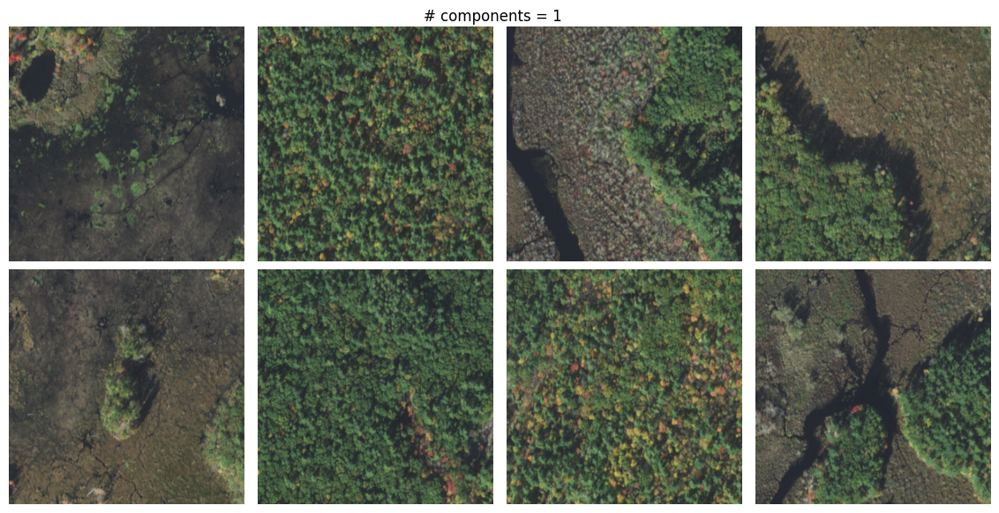

  0%|          | 0/8 [00:00<?, ?it/s]

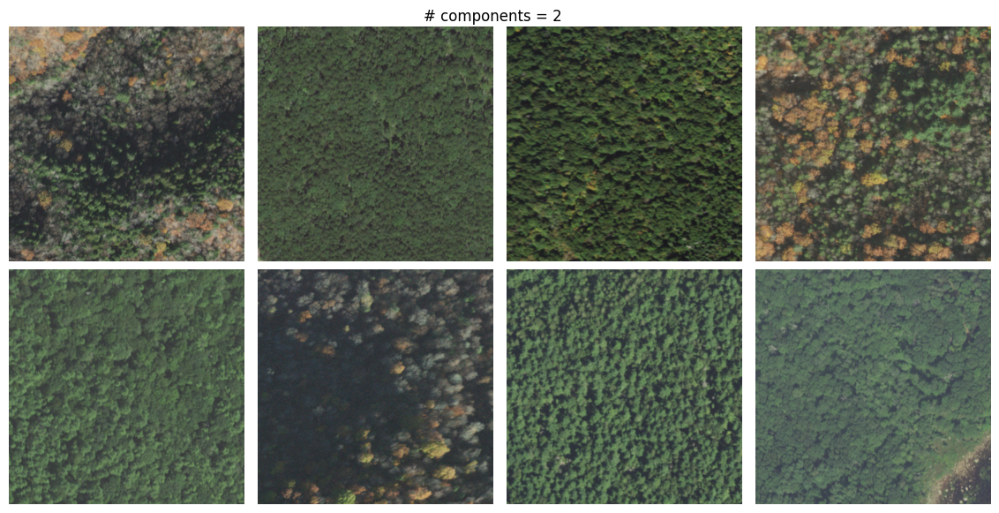

  0%|          | 0/8 [00:00<?, ?it/s]

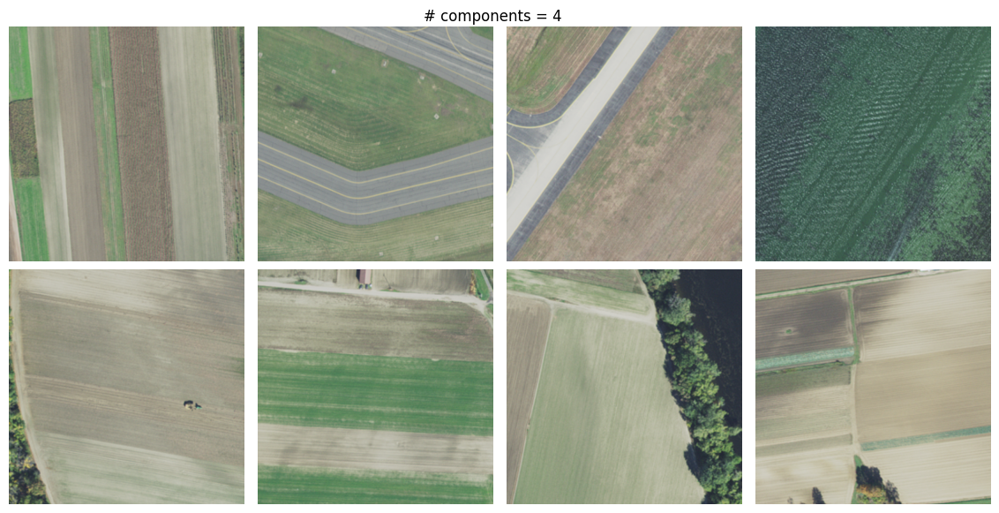

  0%|          | 0/8 [00:00<?, ?it/s]

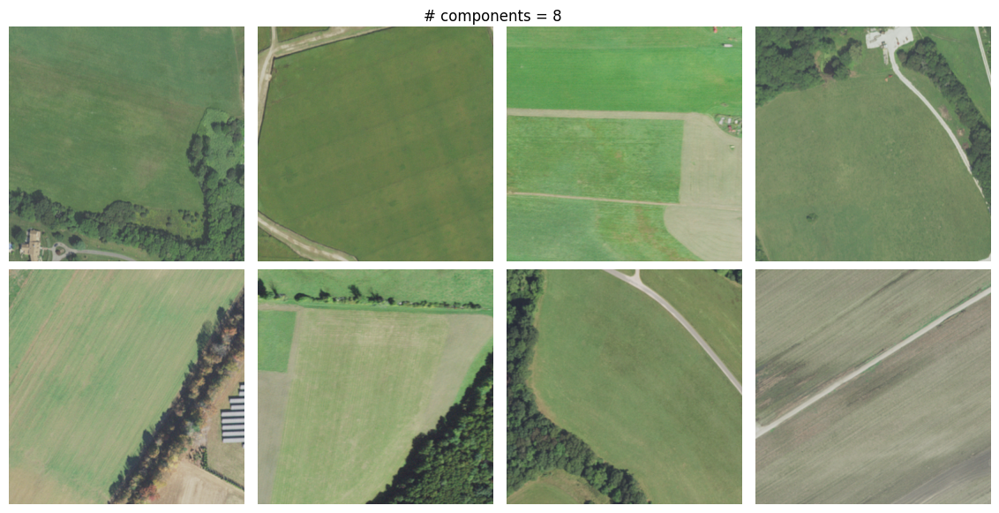

  0%|          | 0/8 [00:00<?, ?it/s]

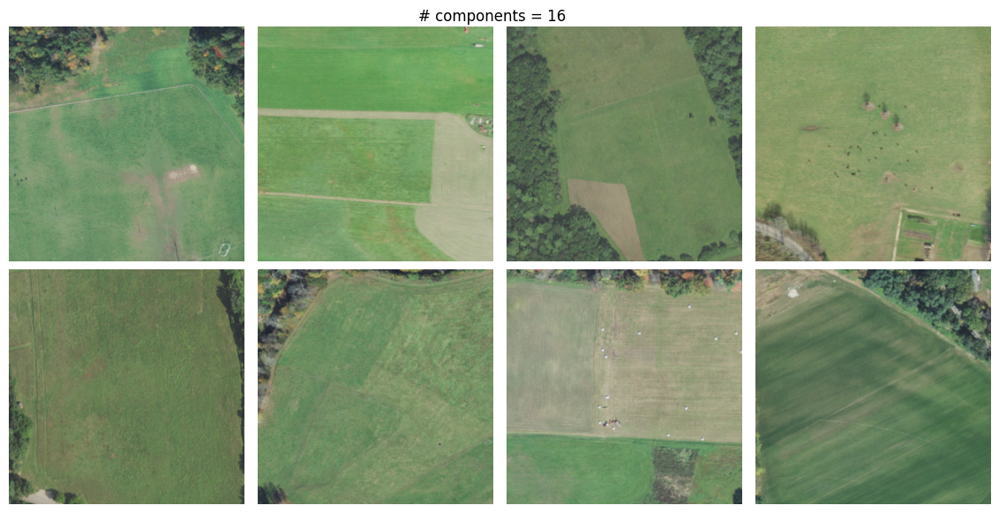

  0%|          | 0/8 [00:00<?, ?it/s]

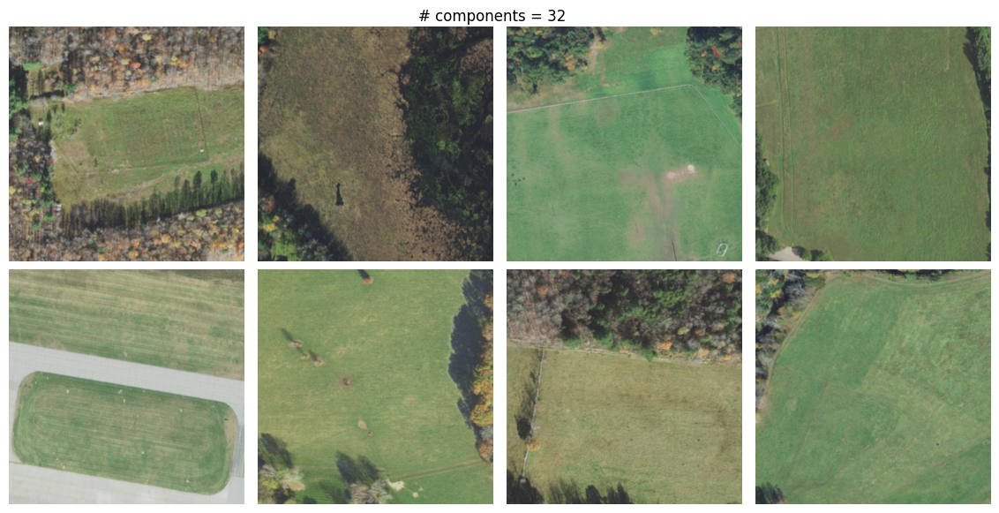

  0%|          | 0/8 [00:00<?, ?it/s]

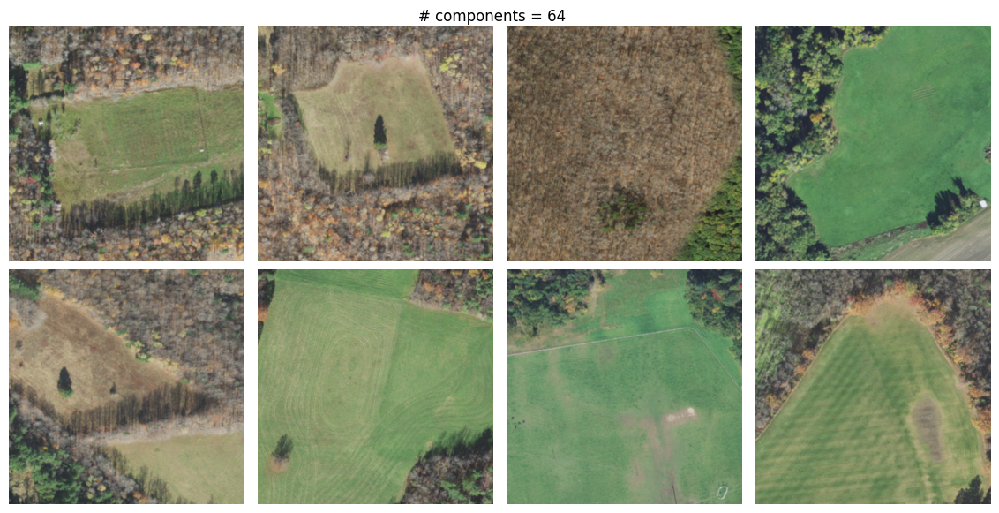

  0%|          | 0/8 [00:00<?, ?it/s]

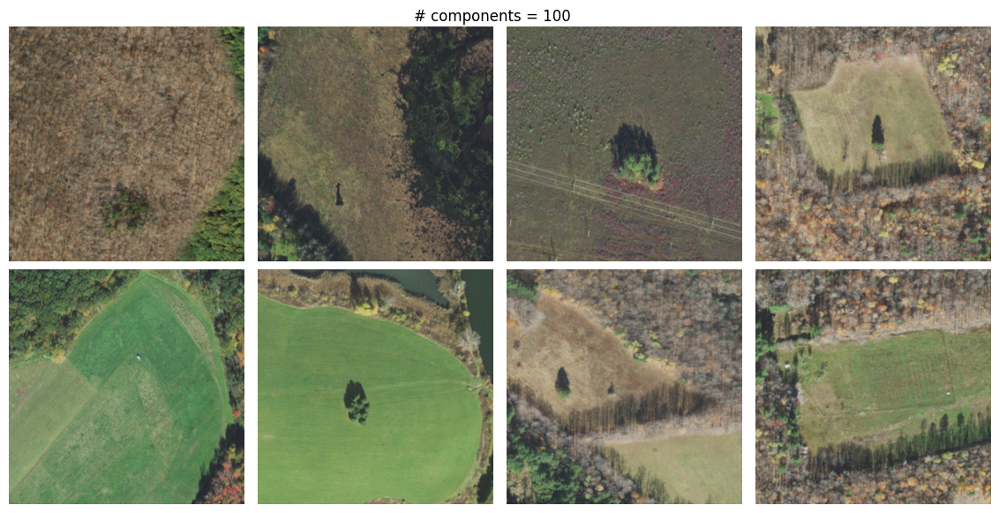

  0%|          | 0/8 [00:00<?, ?it/s]

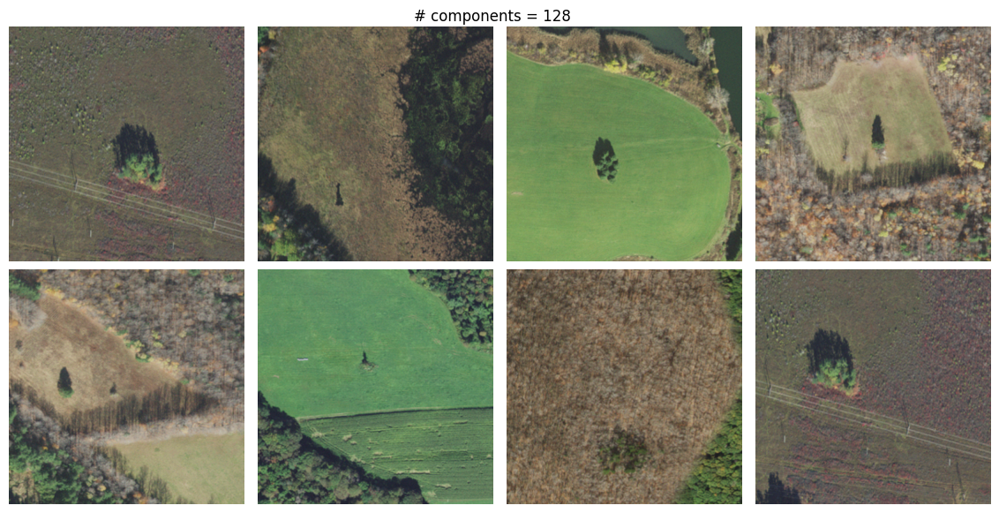

  0%|          | 0/8 [00:00<?, ?it/s]

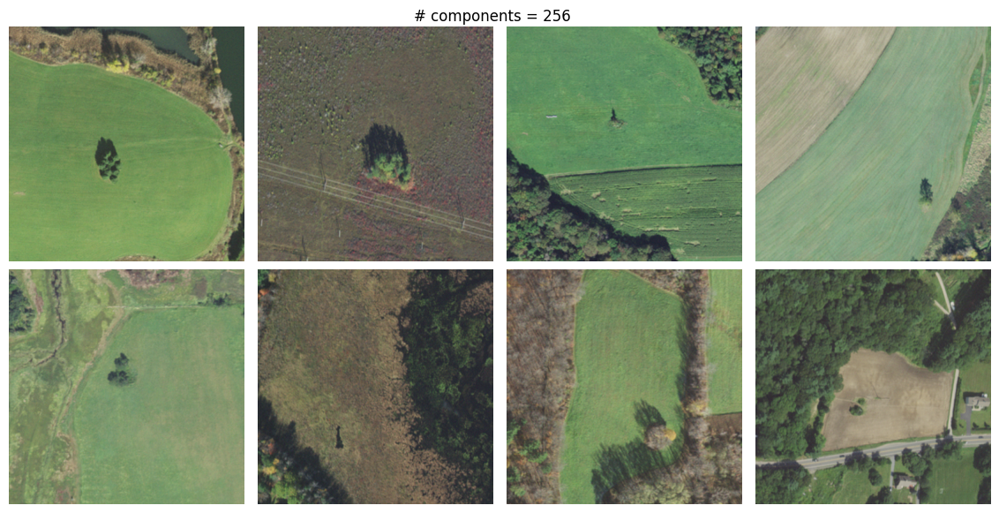

  0%|          | 0/8 [00:00<?, ?it/s]

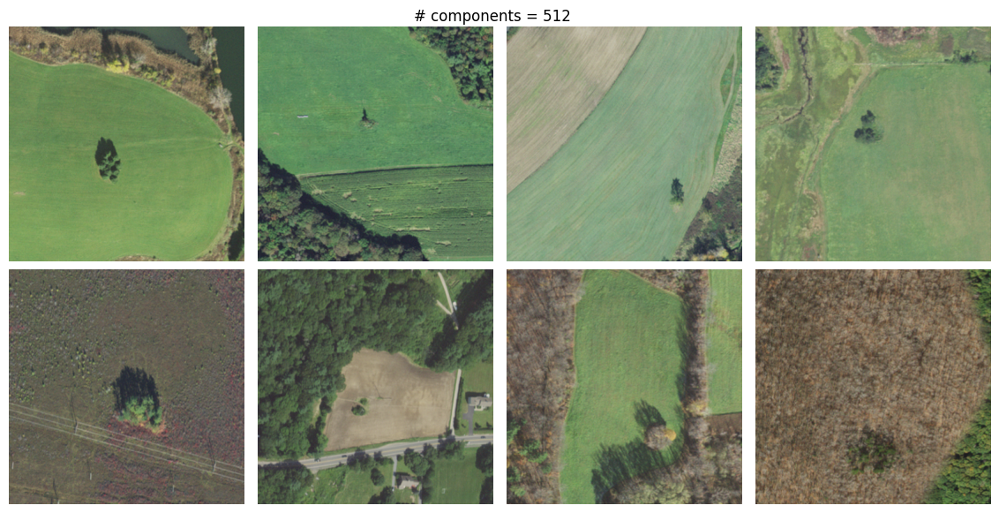

  0%|          | 0/8 [00:00<?, ?it/s]

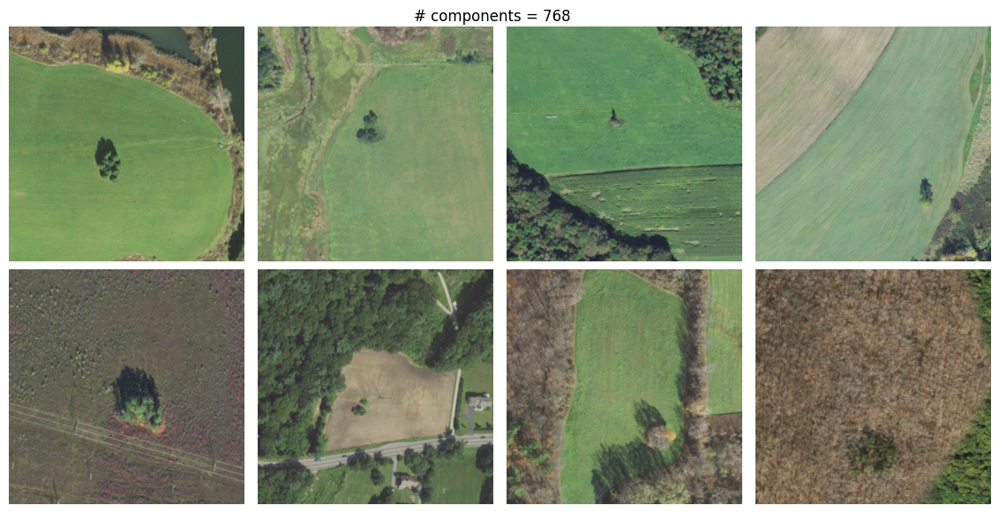

In [42]:
num_pcs_to_chip_scores_corr = {}
num_pcs_to_chip_scores_rank_corr = {}
num_pcs_all = [1, 2, 4, 8, 16, 32, 64, 100, 128, 256, 512, 768]
with tqdm(num_pcs_all) as bar, torch.inference_mode():
    for num_pcs in bar:
        text_emb_pc = torch.from_numpy(text_emb_pca[:, :num_pcs])
        image_emb_pc = torch.from_numpy(image_embs_pca[:, :num_pcs])
        chip_scores_pca = _get_chip_scores(text_emb_pc, image_emb_pc)
        num_pcs_to_chip_scores_corr[num_pcs] = np.corrcoef(chip_scores_pca, chip_scores_baseline)[0,1]
        num_pcs_to_chip_scores_rank_corr[num_pcs] = spearmanr(chip_scores_pca, chip_scores_baseline).statistic
        _ = show_top_chips(chip_scores_pca, windows_df_400, nrows=2, ncols=4, figsize=(12, 6), w_pad=-(12/4), h_pad=-(6/4), title=f'# components = {num_pcs}')

In [43]:
num_pcs_to_chip_scores_corr

{1: 0.18130276521610547,
 2: 0.7210098411341028,
 4: 0.7278576942013686,
 8: 0.9018672683282117,
 16: 0.945647398665953,
 32: 0.9662231652883135,
 64: 0.9813425505884515,
 100: 0.9909533581264195,
 128: 0.9947538998417476,
 256: 0.99837352620703,
 512: 0.9997974454618025,
 768: 0.9999999999651248}

In [44]:
num_pcs_to_chip_scores_rank_corr

{1: 0.14851503034142294,
 2: 0.6713751870568695,
 4: 0.6690954084800703,
 8: 0.8921147292442143,
 16: 0.9430513787476885,
 32: 0.9624532900987482,
 64: 0.9797780390409421,
 100: 0.9901211610301274,
 128: 0.9941113225232465,
 256: 0.9981334372061936,
 512: 0.9997699438165369,
 768: 0.9999999999378808}

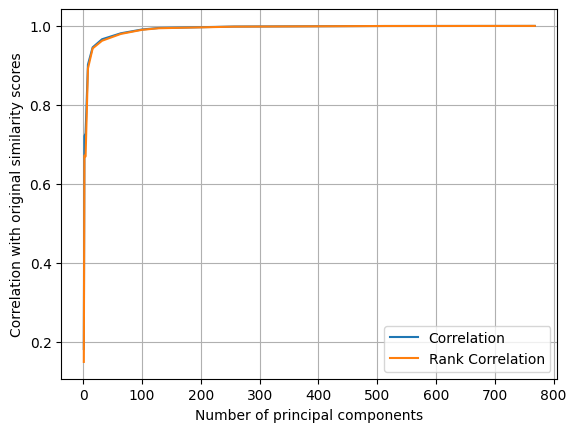

In [45]:
plt.close('all')
fig, ax = plt.subplots()
ax.plot(num_pcs_all, list(num_pcs_to_chip_scores_corr.values()), label='Correlation')
ax.plot(num_pcs_all, list(num_pcs_to_chip_scores_rank_corr.values()), label='Rank Correlation')
ax.set_xlabel('Number of principal components')
ax.set_ylabel('Correlation with original similarity scores')
# ax.set_xscale('log')
ax.legend()
ax.grid()
plt.show()

## PCA + quantization

In [ ]:
# num_pcs = 64
# text_emb_pc = torch.from_numpy(text_emb_pca[:, :num_pcs])
# image_emb_pc = torch.from_numpy(image_embs_pca[:, :num_pcs])
# _min, _max = image_emb_pc.min(), image_emb_pc.max()
# image_emb_pc = (image_emb_pc - _min) / (_max - _min)
# image_emb_pc_quantized = (image_emb_pc * 255).to(dtype=torch.uint8) / 255.
# image_emb_pc_quantized = image_emb_pc_quantized * (_max - _min) + _min

In [ ]:
# chip_scores_quantizated = _get_chip_scores(text_emb_pc, image_emb_pc_quantized)
# np.corrcoef(chip_scores_quantizated, chip_scores_baseline)[0, 1], spearmanr(chip_scores_quantizated, chip_scores_baseline).statistic

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

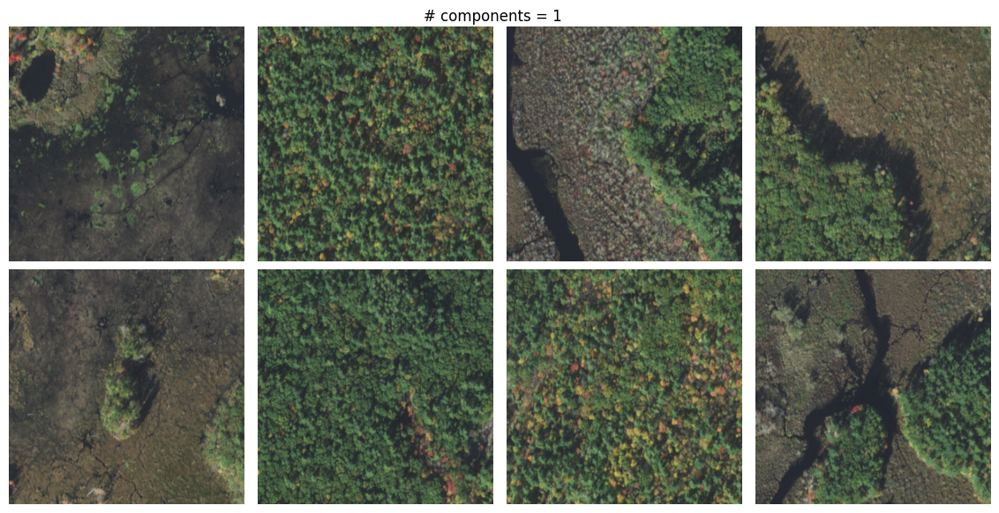

  0%|          | 0/8 [00:00<?, ?it/s]

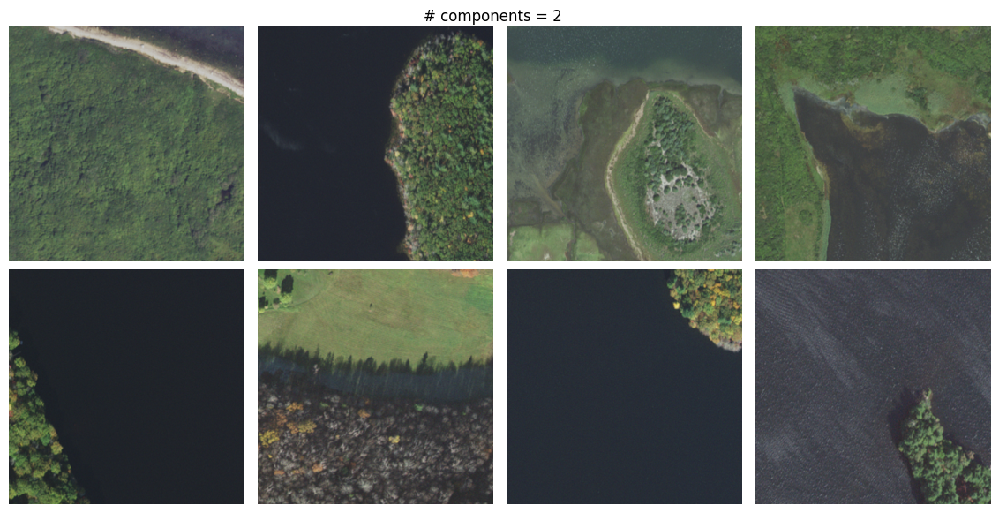

  0%|          | 0/8 [00:00<?, ?it/s]

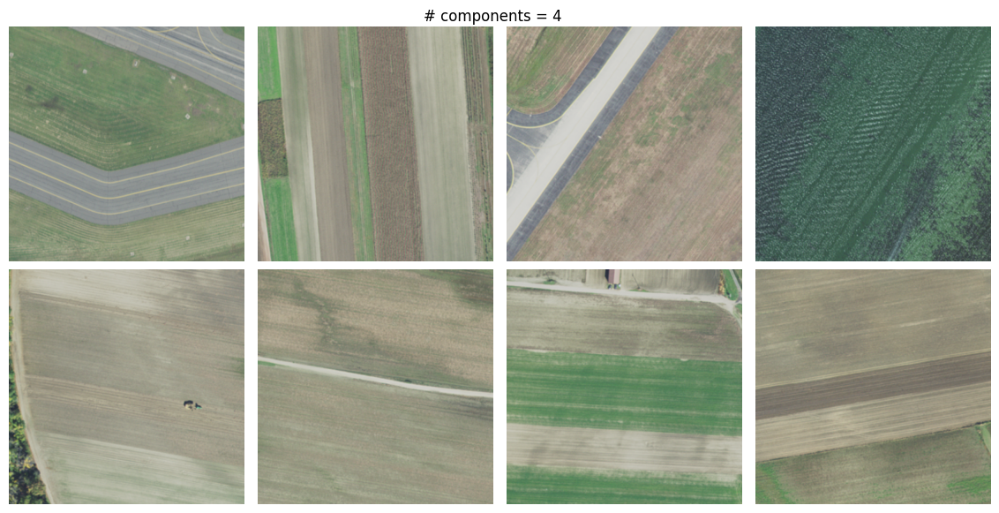

  0%|          | 0/8 [00:00<?, ?it/s]

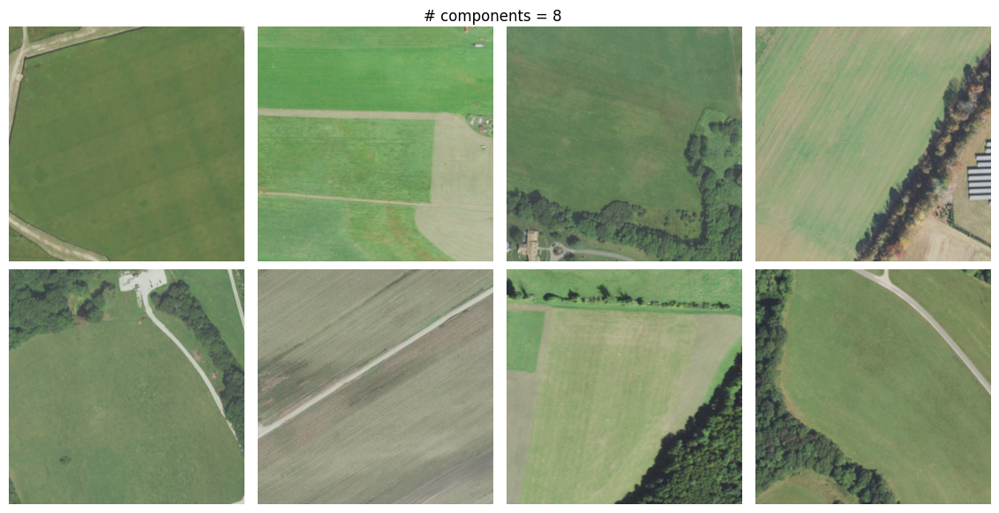

  0%|          | 0/8 [00:00<?, ?it/s]

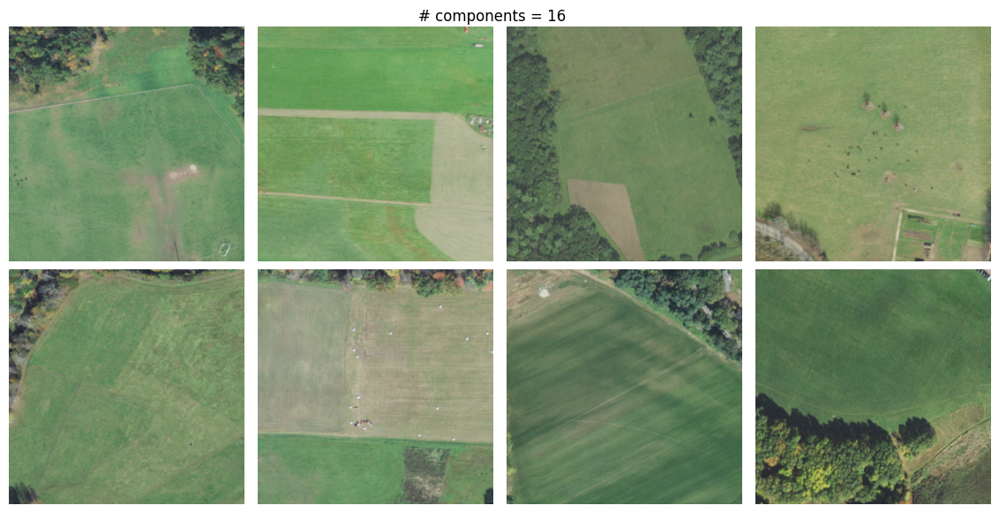

  0%|          | 0/8 [00:00<?, ?it/s]

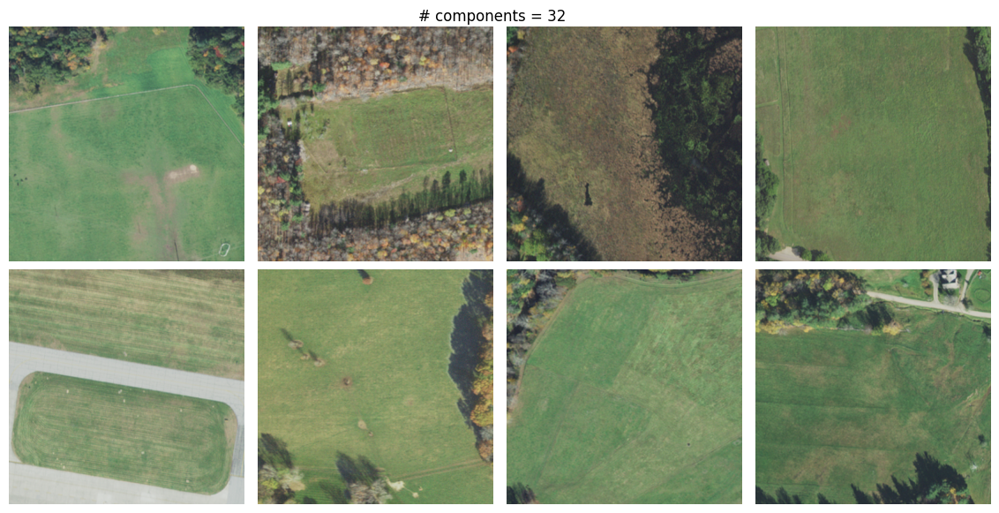

  0%|          | 0/8 [00:00<?, ?it/s]

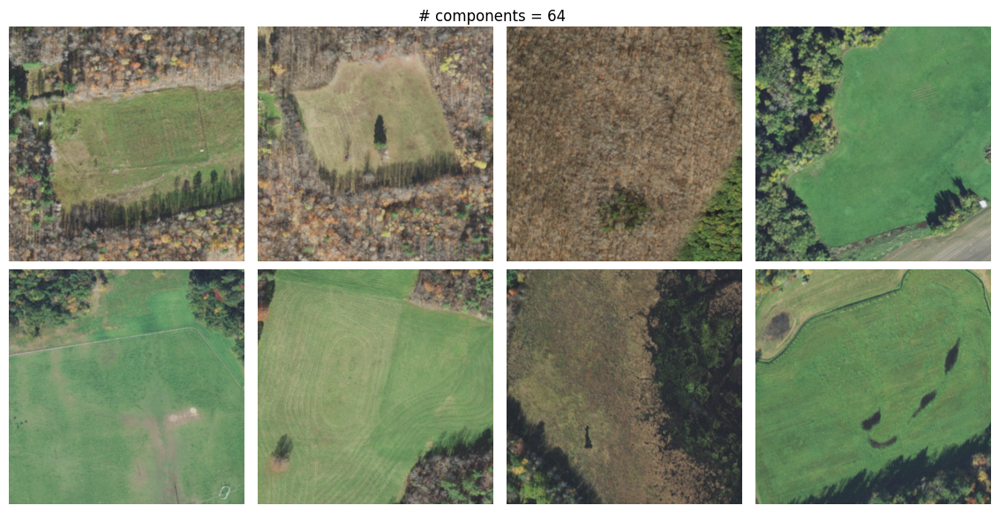

  0%|          | 0/8 [00:00<?, ?it/s]

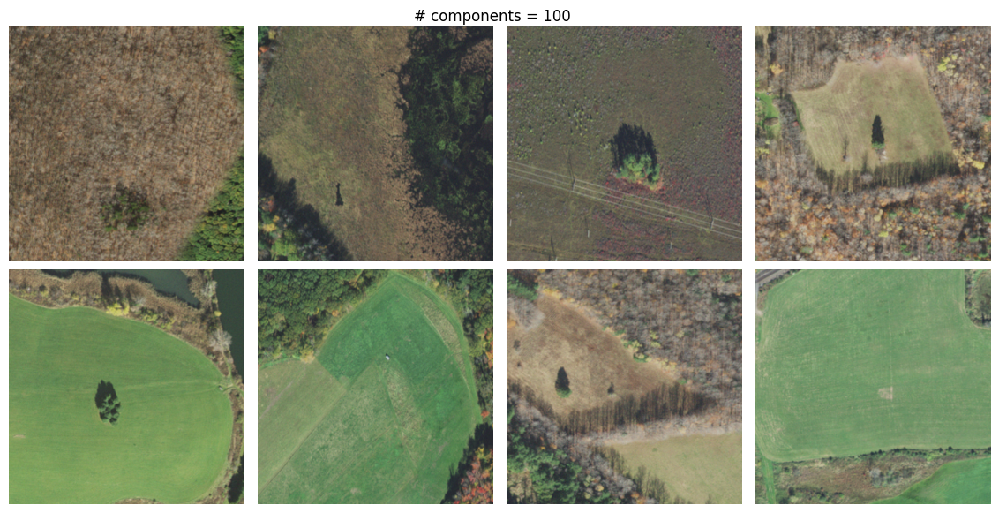

  0%|          | 0/8 [00:00<?, ?it/s]

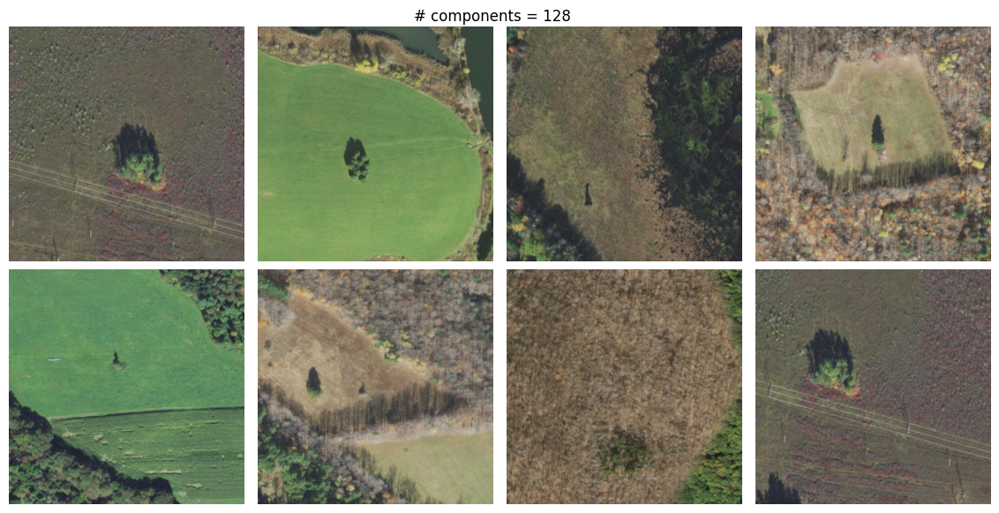

  0%|          | 0/8 [00:00<?, ?it/s]

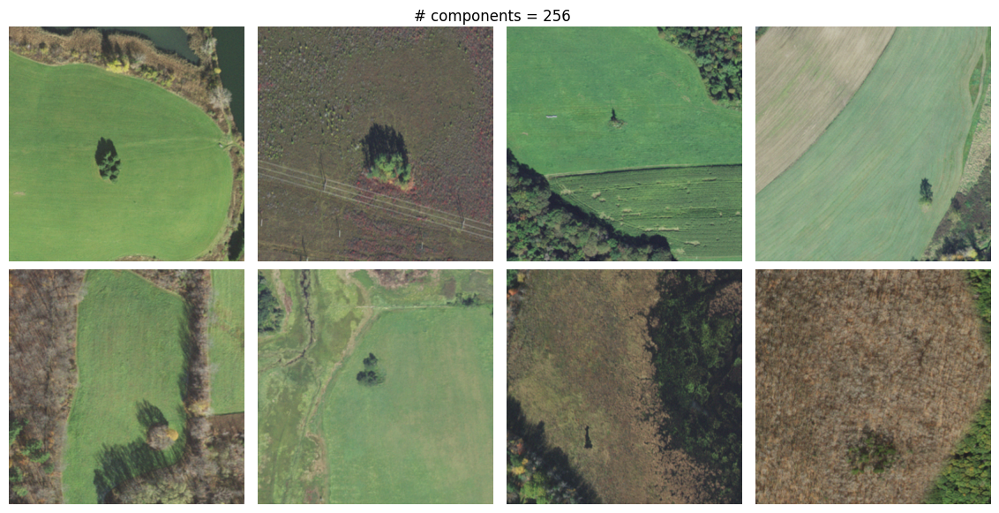

  0%|          | 0/8 [00:00<?, ?it/s]

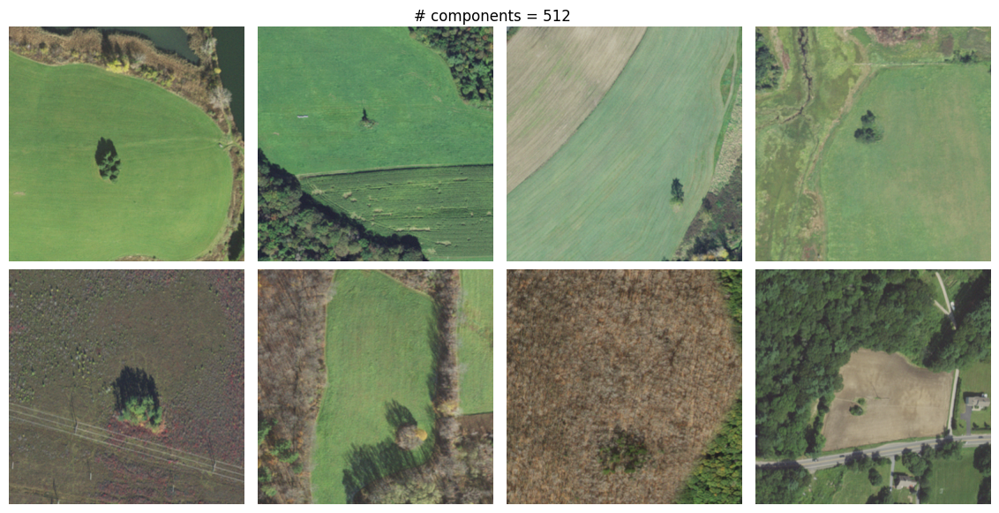

  0%|          | 0/8 [00:00<?, ?it/s]

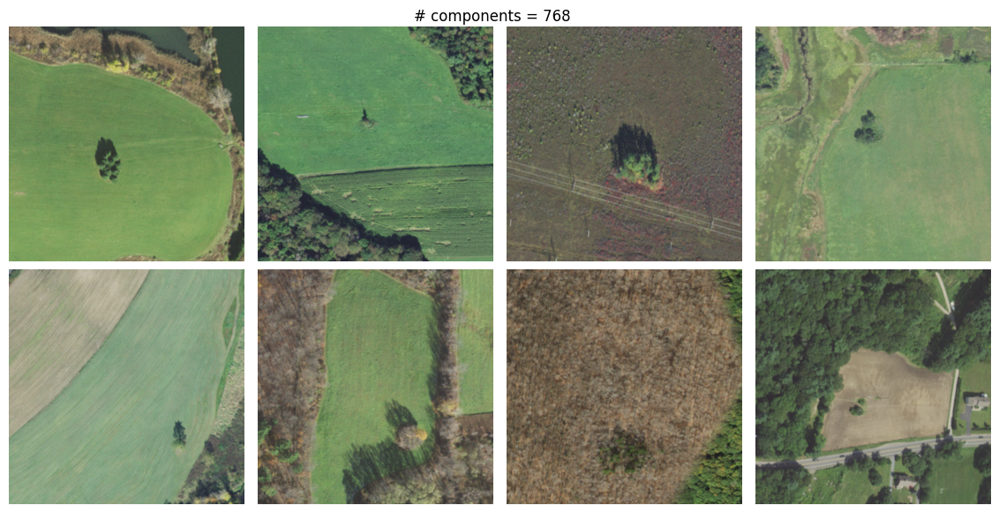

In [46]:
num_pcs_to_chip_scores_corr_q = {}
num_pcs_to_chip_scores_rank_corr_q = {}
num_pcs_all = [1, 2, 4, 8, 16, 32, 64, 100, 128, 256, 512, 768]
with tqdm(num_pcs_all) as bar, torch.inference_mode():
    for num_pcs in bar:
        text_emb_pc = torch.from_numpy(text_emb_pca[:, :num_pcs])
        image_emb_pc = torch.from_numpy(image_embs_pca[:, :num_pcs])
        _min, _max = image_emb_pc.min(), image_emb_pc.max()
        image_emb_pc = (image_emb_pc - _min) / (_max - _min)
        image_emb_pc_quantized = (image_emb_pc * 255).to(dtype=torch.uint8) / 255.
        image_emb_pc_quantized = image_emb_pc_quantized * (_max - _min) + _min
        chip_scores_pca_quantized = _get_chip_scores(text_emb_pc, image_emb_pc_quantized)
        num_pcs_to_chip_scores_corr_q[num_pcs] = np.corrcoef(chip_scores_pca_quantized, chip_scores_baseline)[0,1]
        num_pcs_to_chip_scores_rank_corr_q[num_pcs] = spearmanr(chip_scores_pca_quantized, chip_scores_baseline).statistic
        _ = show_top_chips(chip_scores_pca_quantized, windows_df_400, nrows=2, ncols=4, figsize=(12, 6), w_pad=-(12/4), h_pad=-(6/4), title=f'# components = {num_pcs}')

---

In [58]:
719 * (256 / 768)

239.66666666666666

In [2]:
719 * (256 / 768) * 0.25

59.916666666666664

In [3]:
(719 * 1024) * (256 / 768) * 0.25 * 0.023 * 12

16933.888

---

In [ ]:
!wget "https://github.com/PublicaMundi/MappingAPI/blob/master/data/geojson/us-states.json"

In [ ]:
us_df = gpd.read_file('us-states.json')
aoi_df = us_df[us_df.name == 'Massachusetts']

In [ ]:
top_inds = torch.topk(chip_scores_400, 100).indices
matched_windows_df = windows_df_400.iloc[top_inds]

In [ ]:
fig, ax = plt.subplots()
aoi_df.plot(ax=ax, ec='gray', fc='none')
intersection_df = matched_windows_df[matched_windows_df.within(aoi_df.unary_union)]
ax.scatter(intersection_df.centroid.x, intersection_df.centroid.y, s=16)
plt.show()

---

In [ ]:
boston_df = gpd.read_file('City_of_Boston_Boundary_(Water_Excluded).geojson')

In [ ]:
boston_windows_df_400 = windows_df_400[windows_df_400.within(boston_df.unary_union)]
boston_inds_400 = boston_windows_df_400.emb_idx.to_numpy()
windows_df_boston_400 = windows_df_400.iloc[boston_inds]

In [ ]:
chip_scores_boston_400 = chip_scores_400[boston_inds_400]
top_inds = torch.topk(chip_scores_boston_400, 100).indices
matched_windows_df = windows_df_boston_400.iloc[top_inds]

In [ ]:
fig, ax = plt.subplots()
boston_df.plot(ax=ax, ec='gray', fc='none')
# boston_df.plot(ax=ax)
intersection_df = matched_windows_df[matched_windows_df.within(boston_df.unary_union)]
ax.scatter(intersection_df.centroid.x, intersection_df.centroid.y, s=8)
# ax.set_title('Boston: shipping facilities (top 100 matches)')
ax.set_title(f'Boston: {text_queries[0]} (top 100 matches)')
plt.show()

In [ ]:
fig.savefig(f'boston_{text_queries[0]}_map.png', bbox_inches='tight', pad_inches=0.2, transparent=False)

In [ ]:
fig = show_top_chips(chip_scores_boston_400, windows_df_boston_400, nrows=3, ncols=4, figsize=(12, 9), w_pad=-(12/4), h_pad=-(6/4))

In [ ]:
fig.savefig(f'boston_{text_queries[0]}.png', bbox_inches='tight', pad_inches=0.2, transparent=False)

In [ ]:
def loc_to_gmaps_url(loc):
    return f'https://www.google.com/maps/@{loc.y},{loc.x},220m/data=!3m1!1e3'

In [ ]:
locs = matched_windows_df.iloc[:12].centroid
print('\n'.join([loc_to_gmaps_url(loc) for loc in locs.tolist()]))

---

In [ ]:
boston_df = gpd.read_file('City_of_Boston_Boundary_(Water_Excluded).geojson')

In [ ]:
boston_windows_df = windows_df_800[windows_df_800.within(boston_df.unary_union)]
windows_df_boston_800 = windows_df_800.iloc[boston_inds]

In [ ]:
boston_inds = boston_windows_df.emb_idx.to_numpy()
chip_scores_boston_800 = chip_scores_800[boston_inds]
chip_scores_boston_800.shape

In [ ]:
top_inds = torch.topk(chip_scores_boston_800, 30).indices
matched_windows_df = windows_df_boston_800.iloc[top_inds]

In [ ]:
fig, ax = plt.subplots()
boston_df.plot(ax=ax, ec='gray', fc='none')
# boston_df.plot(ax=ax)
intersection_df = matched_windows_df[matched_windows_df.within(boston_df.unary_union)]
ax.scatter(intersection_df.centroid.x, intersection_df.centroid.y, s=16)
plt.show()

In [ ]:
show_top_chips(chip_scores_boston_800, windows_df_boston_800, nrows=2, ncols=4, figsize=(12, 6), w_pad=-(12/4), h_pad=-(6/4))